In [1]:
# Adding the neccecary imports to our code
import matplotlib.pyplot as plt
import numpy as np
import pydot # conda install pydot
import math
from data_structures import Graph_part_four,Edge,FVertex
from itertools import permutations
import copy
from scipy.special import comb

In [2]:
#type of data:
url_Les_Miserables_network  = '../data/LesMiserables.dot'
url_Rome_graph  = '../data/rome.dot'
url_Jazz_Network  = '../data/JazzNetwork.dot'
url_Small_Directed_Network  = '../data/noname.dot'
url_Pro_League_Network  = '../data/LeagueNetwork.dot'
url_Argumentation_network  = '../data/devonshiredebate_withclusters.dot'
url_Argumentation_network_for_part_five = '../data/devonshiredebate_withonlytwoclusters.dot'
url_Political_blogosphere_network  = '../data/polblogs.dot'
url = url_Pro_League_Network

In [3]:
def create_custom_graph(G): # O(V) + O(E) + O(V) + O(E) = O(2V + 2E) = O(V + E)
    # Parsing the vertices and edges from the generated graph into lists
    vertices = [n.get_name() for n in G.get_node_list()] # O(V)
    edges = [(edge.get_source(),edge.get_destination(),edge.get_attributes()) for edge in G.get_edge_list()] # O(E)
    graph = Graph_part_four()
    for vertex in vertices: # O(V)
        vertex = FVertex(vertex, 0, 0)  # Initialize the vertex with ID and default coordinates
        graph.add_vertex(vertex)
    for edge in edges: # O(E)
        w=0
        if ("JazzNetwork" not in url):
             w = list(edge[2].values())[0].strip("\"")
        if (float(w)<1.0 or float(w)>3.0) and ("LeagueNetwork" in url):
            continue
        source_vertex = graph.get_vertex(edge[0])
        neighbor_vertex = graph.get_vertex(edge[1])
        if source_vertex.id == '"\\n"' or neighbor_vertex.id == '"\\n"':
          continue
        if source_vertex is None:
            source_vertex = FVertex(edge[0], 0, 0)
        if neighbor_vertex is None:
            neighbor_vertex = FVertex(edge[1], 0, 0)
        source_vertex.add_neighbor(neighbor_vertex)
        source_vertex.add_children(neighbor_vertex)
        neighbor_vertex.add_parents(source_vertex)
        graph.add_edge(Edge(source_vertex, neighbor_vertex))
    return graph

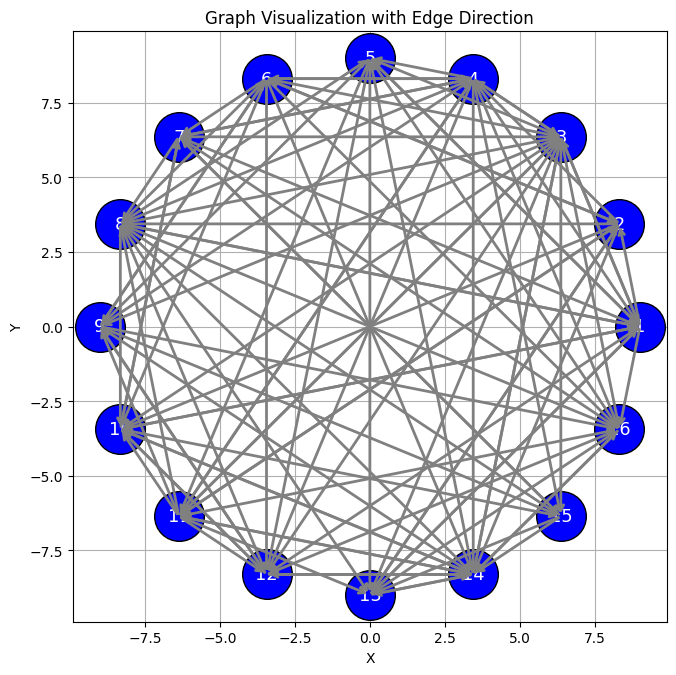

In [4]:
# Parsing the data from the dot file:
G = pydot.graph_from_dot_file(url)[0]
#Convering the graph into our custom graph
graph = create_custom_graph(G) #O(V) + O(E) = O(V + E)
# Visualize the graph

fig_size=5+len(graph.vertices)/6 # new line
radius=5+len(graph.vertices)/4 # new line

graph.visualize_graph(fig_size,radius) #O(V + E)

In [5]:
def remove_sink_vertices(G, h_graph):
  sink = 1
  while sink == 1:

      sink = 0
      for v1 in G.vertices:

        #if it doesnt have children then is sink add them to the sink graph
        if not v1.children:
          sink = 1

          #add sink node to the new graph
          h_graph.add_vertex(v1)

          #remove node from original
          G.remove_vertex(v1.id)

          for v2 in v1.parents:
            #Add sink edges to the new graph
            h_graph.add_edge(Edge(v2, v1 ))

            #remove edges from original
            G.remove_edge(v2, v1)
            #remove v1 as parent of v2
            v2.children.remove(v1)
  return G, h_graph



def remove_source_vertices(G, h_graph):
  source = 1
  while source == 1:
      source = 0
      for v1 in G.vertices:

        #if it doesnt have children then is sink add them to the sink graph
        if not v1.parents:
          source = 1

          #add sorce node to the new graph
          h_graph.add_vertex(v1)
          #remove node from original
          G.remove_vertex(v1.id)

          for v2 in v1.children:

            #Add source edge to the new graph
            h_graph.add_edge(Edge(v1, v2))

            #remove edges from original
            G.remove_edge(v1, v2)
            #remove v1 as parent of v2
            v2.parents.remove(v1)

  return G, h_graph

def remove_maximal_vertex(G, h_graph, reverse_edges, x):

  if bool(G.vertices):

      #Choose vertex with maximum
      current_vertex = G.vertices[0]
      max = abs(len(current_vertex.parents)-len(current_vertex.children))
      for v1 in G.vertices:
        cur = abs(len(v1.parents)-len(v1.children))
        if cur > max:
          max = cur
          current_vertex = v1
        if cur == max:
          if len(v1.parents) < len(current_vertex.parents):
            max = cur
            current_vertex = v1

      #add current vertex to the new graph
      h_graph.add_vertex(current_vertex)

      #remove current vertex from original
      G.remove_vertex(current_vertex.id)

      for c in current_vertex.children:
        #Add source edge to the new graph
        h_graph.add_edge(Edge(current_vertex, c))

        #remove edges from original
        G.remove_edge(current_vertex, c)
        #remove v1 as parent of v2
        c.parents.remove(current_vertex)

      for p in current_vertex.parents:
        reverse_edges.append(Edge(p, current_vertex))

  return G, h_graph, reverse_edges



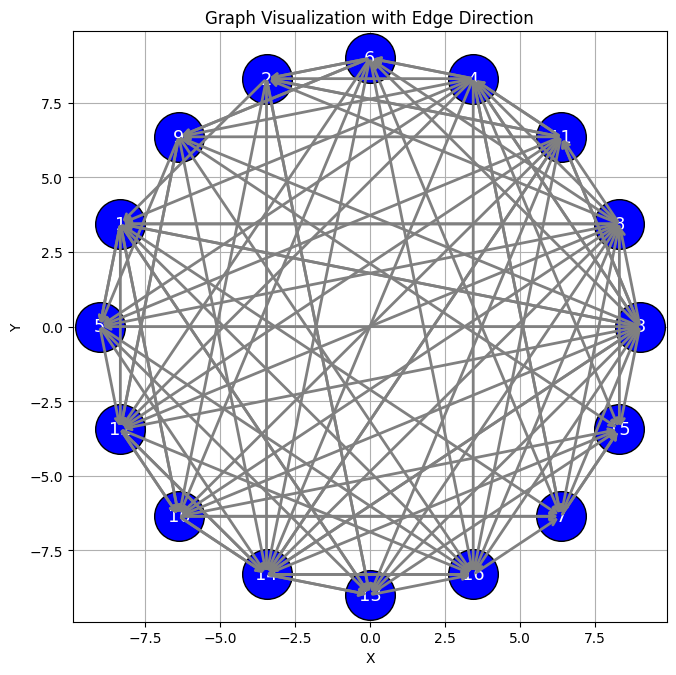

In [6]:
def heuristic_guarantees(G):

  h_graph = Graph_part_four()
  reverse_edges = []
  x=1
  while G.vertices:

    G, h_graph = remove_sink_vertices(G, h_graph)

    G, h_graph = remove_source_vertices(G, h_graph)

    G, h_graph, reverse_edges = remove_maximal_vertex(G,h_graph, reverse_edges, x)
    x=0

  #add the reversed edges
  for reverse in reverse_edges:
    h_graph.remove_edge(reverse.start, reverse.end)
    h_graph.add_edge(Edge(reverse.end, reverse.start))

  return(h_graph,reverse_edges)
copied_graph = copy.deepcopy(graph)
dag, reverse_edges = heuristic_guarantees(copied_graph)

# Visualize the graph###################################################
fig_size=5+len(dag.vertices)/6 # new line
radius=5+len(dag.vertices)/4 # new line
dag.visualize_graph(fig_size,radius) #O(V + E)

if '"\n"' in dag.vertices:
    del dag.vertices["\n"]


In [7]:
def update_parents_children(G):

  for vertex in G.vertices:
    vertex.parents.clear()
    vertex.children.clear()

  for edge in G.edges:
    edge.start.add_children(edge.end)
    edge.end.add_parents(edge.start)

  return(G)

def sources_of_graph(G):
  sources = []
  for v in G.vertices:
    if not v.parents:
      sources.append(v)

  return(sources)

def update_graph(G, sources):

  for v in sources:
    G.remove_vertex(v.id)
    for c in v.children:
      #remove edges from original
      G.remove_edge(v, c)
      #remove v as parent of c
      c.parents.remove(v)
  return(G)

def layer_assignment(G):

  sources = sources_of_graph(G)
  layers = []
  while sources:
    layers.append(sources)
    G = update_graph(G, sources)
    sources = sources_of_graph(G)

  return(layers)


copied_graph = copy.deepcopy(dag)
copied_graph = update_parents_children(copied_graph)#O(V+E)
layers = layer_assignment(copied_graph)

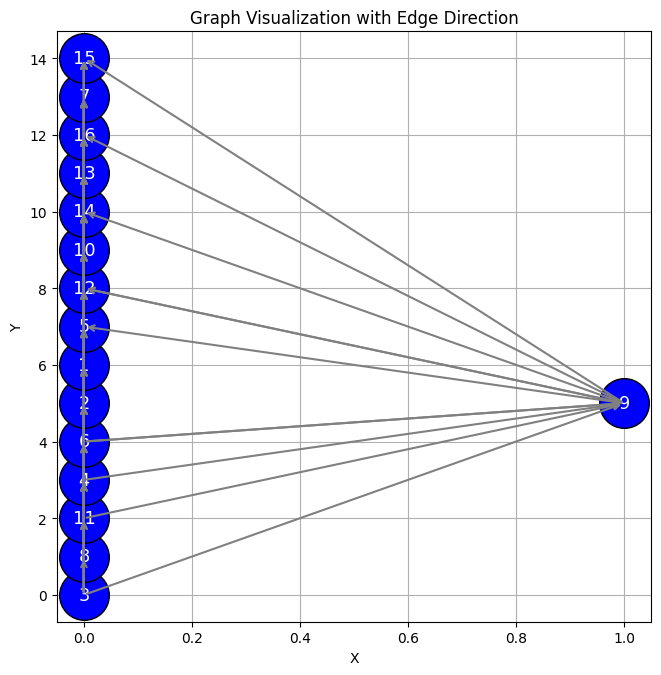

In [8]:
def visualize_layerd_graph(layers, G, fig_size, radius):
  fig, ax = plt.subplots(figsize=(fig_size, fig_size))  # Adjust width and height as needed
  # Plot Vertices
  scaling_factor = 1 / len(G.vertices)
  for idx,layer in enumerate(layers):
      for idx1,vertex in enumerate(layer):
          G.update_x_y(vertex.id, idx1, idx)
          ax.scatter(idx1, idx, color='blue', zorder=2, s=scaling_factor * 40000 * (fig_size / 15),
                    edgecolors='black')
          ax.text(idx1, idx, str(vertex.id), fontsize=(scaling_factor * 40000 * (fig_size / 15)) / 100,
                  ha='center', va='center', zorder=len(G.vertices) * scaling_factor * 2, color='white')

  for edge in G.edges:
        start = edge.start
        end = edge.end
        dx = end.x - start.x
        dy = end.y - start.y
        ax.annotate("", xy=(end.x, end.y), xytext=(start.x, start.y),
                    arrowprops=dict(arrowstyle="->", linewidth=1.5, color='gray'))

  ax.set_xlabel('X')
  ax.set_ylabel('Y')
  ax.set_title('Graph Visualization with Edge Direction')
  ax.grid(True)
  plt.show()

copied_graph = copy.deepcopy(dag)
fig_size=5+len(copied_graph.vertices)/6 # new line
radius=5+len(copied_graph.vertices)/4 # new line

visualize_layerd_graph(layers, copied_graph, fig_size, radius)#O(v^2+E)

In [9]:

def insert_dummies(layers, G):

  for idx, layer in enumerate(layers):
    for idx1, vertex in enumerate(layer):
      G.update_x_y(vertex.id, idx1, idx)

  dummy_num = 0
  #Add dummy node and esdges
  edges = G.edges[:]
  for edge in edges:
      start = edge.start
      end = edge.end


      if abs(start.y - end.y) > 1:  # Check if the edge spans more than 1 layer
          # Choose the layer for the dummy node
          numberOfDum=abs(start.y - end.y)-1
          add_factor= 0

          prev_vertex = start
          next_vertex = None

          while numberOfDum > 0:

              add_factor =add_factor + 1
              dummy_layer = min(start.y, end.y) + add_factor  # Place the dummy node in the middle of the layers

              #create the dummy
              dummy_id ="D"+ str(dummy_num)+"_s"+str(start.id)+"_e"+str(end.id)
              dummy_vertex = FVertex(dummy_id, 0, 0)
              G.add_vertex(dummy_vertex)


              #put the dummy in the right layer over its parent
              layers[dummy_layer].insert(start.x, dummy_vertex)


              #add the edges
              next_vertex = dummy_vertex
              G.add_edge(Edge(prev_vertex,next_vertex))

              prev_vertex = next_vertex

              numberOfDum = numberOfDum - 1
              dummy_num+=1

          G.add_edge(Edge(prev_vertex,end))
          #remove the direct node
          G.remove_edge(start, end)

  return layers, G


layered_dummies_graph = copy.deepcopy(dag)
layers, layered_dummies_graph = insert_dummies(layers, layered_dummies_graph)

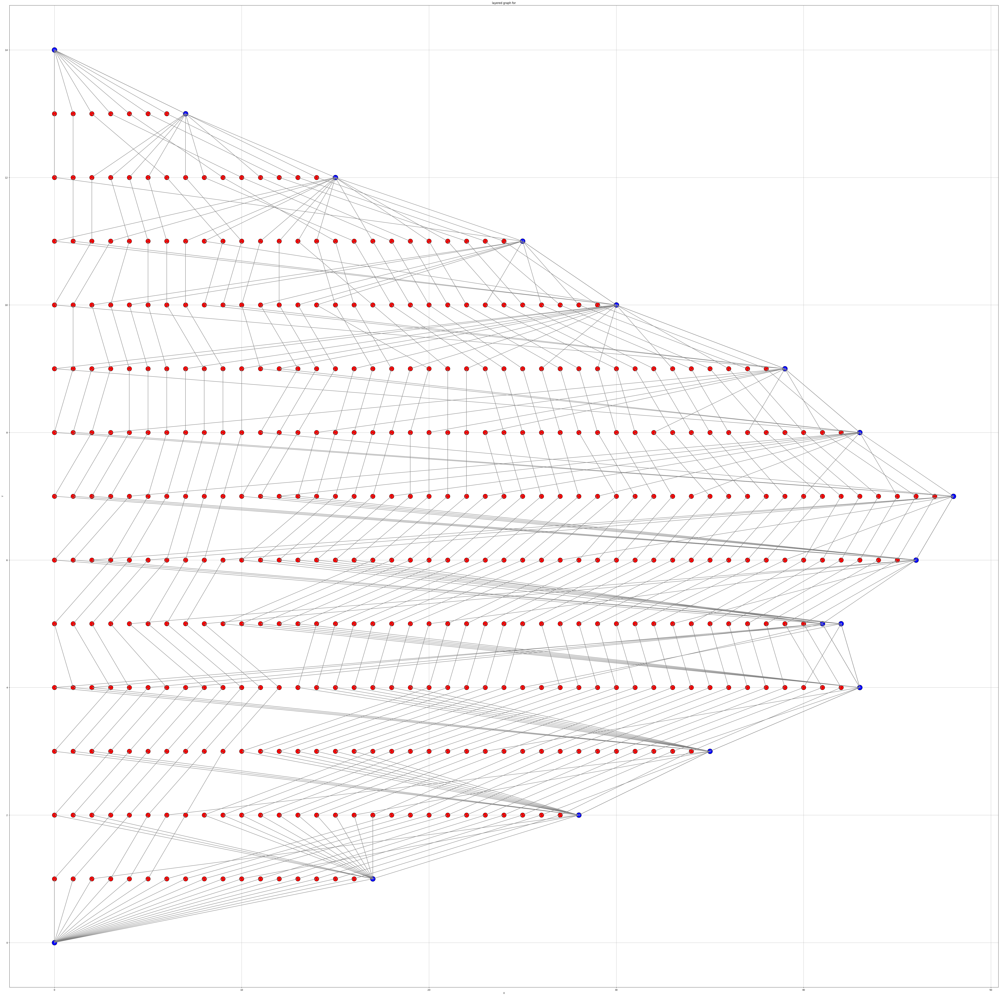

In [10]:

def visualize_layered_graph_with_dummies(layers, G, fig_size, radius):

    fig, ax = plt.subplots(figsize=(fig_size, fig_size))  # Adjust width and height as needed

    # Plot Vertices
    scaling_factor = 1 / len(G.vertices)
    for idx,layer in enumerate(layers):
        for idx1,vertex in enumerate(layer):
            #update_x_y
            G.update_x_y(vertex.id, idx1, idx)
            if vertex.id.startswith("D"):
              ax.scatter(idx1, idx, color='red', zorder=2, s=(scaling_factor * 40000 * (fig_size / 15))/1.2,
                        edgecolors='black')
              ax.text(idx1, idx, "D", fontsize=(scaling_factor * 40000 * (fig_size / 15)) / 100,
                      ha='center', va='center', zorder=len(G.vertices) * scaling_factor * 2, color='black')
            else:
              ax.scatter(idx1, idx, color='blue', zorder=2, s=scaling_factor * 40000 * (fig_size / 15),
                      edgecolors='black')
              ax.text(idx1, idx, str(vertex.id), fontsize=(scaling_factor * 40000 * (fig_size / 15)) / 50,
                    ha='center', va='center', zorder=len(G.vertices) * scaling_factor * 2, color='white')

    for edge in G.edges:
        start = edge.start
        end = edge.end
        dx = end.x - start.x
        dy = end.y - start.y
        ax.annotate("", xy=(end.x, end.y), xytext=(start.x, start.y),
                    arrowprops=dict(arrowstyle="->", linewidth=1.5, color='gray'))

    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_title('layered graph for',)
    ax.grid(True)
    plt.show()


fig_size=5+len(layered_dummies_graph.vertices)/6 # new line
radius=5+len(layered_dummies_graph.vertices)/4 # new line


visualize_layered_graph_with_dummies(layers, layered_dummies_graph, fig_size, radius)

In [11]:
#GENERAL FUNCTIONS######################################################
def update_parents_children_in_layers(layers, edges):#O(VE)
  for layer in layers:
    for vertex in layer:
      vertex.parents.clear()
      vertex.children.clear()

  for layer in layers:
    for vertex in layer:
      for edge in edges:
        if vertex.id == edge.end.id:
          vertex.parents.append(edge.start)

        if vertex.id == edge.start.id:
          vertex.children.append(edge.end)

def get_index(layer, target_id):#O(V)

    #find the id on the ayers and get the index
    for idx, vertex in enumerate(layer):
        if vertex.id == target_id:
            return idx
    return None

def calculate_total_crossing(layers):

    crossing_count = 0
    #for each pair of consecutive layers
    for idx, layer in enumerate(layers[:-1]):#O(L)
        first_layer = layer
        second_layer = layers[idx+1]

        #check for every current node in the layer for every other node that is after the current node
        for i in range(len(second_layer)):
          for j in range(i + 1, len(second_layer)):

            #for each parent of the  current node check if there is a parent of the other node that is positioned before the parent of the current node
            for parent_v1 in second_layer[i].parents:
              #get the index of the parent of the first node
              pv1_idx = get_index(first_layer, parent_v1.id)


              for parent_v2 in second_layer[j].parents:
                #get the index of the parent of the second node
                pv2_idx = get_index(first_layer, parent_v2.id)

                #if the parent of v1 is after the parent of v2 it means there is a crossing
                if pv1_idx > pv2_idx:
                  crossing_count +=1

    return(crossing_count)

In [12]:
#BARYCENTER #################################################
def rearange_of_layers_Barycenter(first_layer, second_layer):#O(V^3)

  for vertex in second_layer:#O(V)

    deg = len(vertex.parents)
    sum = 0
    for parent in vertex.parents:#O(V^2)
      sum += get_index(first_layer, parent.id)#O(V)

    if deg == 0:
      continue
    vertex_x = 1/deg * sum

    vertex.x = vertex_x

  second_layer = sorted(second_layer, key=lambda vertex: vertex.x)#O(V)
  return (second_layer)


def rearange_of_layers_reverse_Barycenter(first_layer, second_layer ):#O(V^3)

  for vertex in first_layer:
    deg = len(vertex.children)
    sum = 0
    for child in vertex.children:
      sum += get_index(second_layer, child.id)

    if deg == 0:
      continue
    vertex_x = 1/deg * sum

    vertex.x = vertex_x

  first_layer = sorted(first_layer, key=lambda vertex: vertex.x)
  return (first_layer)

In [13]:
#MEDIAN ###################################################################
def custom_sort_key_a(vertex):

  if (len(vertex.parents)) % 2 == 1 :
      return (vertex.x, 0)
  else:
      return (vertex.x, 1)

def custom_sort_key_b(vertex):
    if (len(vertex.children) ) % 2 == 1 :
        return (vertex.x, 0)
    else:
        return (vertex.x, 1)

def rearange_of_layers_median(first_layer, second_layer):

  for vertex in second_layer:#O(V)

    parents_idx = []
    #get the index of the neighboars of the current node
    for parent in vertex.parents:#O(V)
      parents_idx.append(get_index(first_layer, parent.id))

    parents_idx = sorted(parents_idx)

    #if its zero then put it in position 0
    if len(parents_idx) == 0:
      new_position = 0
    else:
      #else put it in the median position
      new_position = parents_idx[math.ceil((len(parents_idx)) / 2) - 1]

    vertex.x = new_position

  #sorte them based on there position x and check for degree of parity in a case of nodes with the same position
  second_layer = sorted(second_layer, key=custom_sort_key_a)#(Vlog(V))

  return (second_layer)


#same as rearange_of_layers_median but for bottom to top
def rearange_of_layers_median_reverse(first_layer, second_layer):

  for vertex in first_layer:#O(V^3log(V))

    children_idx = []
    for child in vertex.children:#O(V^2log(V))
      children_idx.append(get_index(second_layer, child.id))

    children_idx = sorted(children_idx)#(Vlog(V))

    if len(children_idx) == 0:
      new_position = 0
    else:
      new_position = children_idx[math.ceil((len(children_idx)) / 2) - 1]

    vertex.x = new_position

  first_layer = sorted(first_layer, key=custom_sort_key_b)#(Vlog(V))

  return (first_layer)

In [14]:
#MAIN ITERATIVE ############################################################
def iterative_crossing_minimization(G, layers,oscm):

  for idx, vertex in enumerate(layers[0]):#O(V)
    G.update_x_y(vertex.id, idx, 0)

  min_cross = float('inf')
  layers_with_min = None

  all_permutations = permutations(layers[0])
  #for every permutation of the bottom layer
  for perm in all_permutations:
      layers[0] = perm
      pre_layers = None

      #Repeat until the previous ordering is the same as the current ordering
      while pre_layers != layers:
        pre_layers = layers

        #Bottom to top
        for idx, layer in enumerate(layers[:-1]):
          first_layer = layer
          second_layer = layers[idx+1]

          #rearrange the top layer
          if oscm == "Bary":
            second_layer = rearange_of_layers_Barycenter(first_layer, second_layer)
          elif oscm == "Median":
            second_layer = rearange_of_layers_median(first_layer, second_layer)

          layers[idx+1] = second_layer

        #for top to bottom
        for idx in range(len(layers)-1, 0, -1):
          first_layer = layers[idx-1]
          second_layer = layers[idx]

          #rearrange the bottom layer
          if oscm == "Bary":
            first_layer = rearange_of_layers_reverse_Barycenter(first_layer, second_layer )
          elif oscm == "Median":
            first_layer = rearange_of_layers_median_reverse(first_layer, second_layer)

          # Replace the sublist at the found index with the new sublist
          layers[idx-1] = first_layer

      total_cross = calculate_total_crossing(layers)
      #Keep the layers ordering with the minimum crossing
      if total_cross < min_cross:
        min_cross = total_cross
        layers_with_min = layers

  layers = layers_with_min
  print("min", min_cross)


In [15]:
update_parents_children(layered_dummies_graph)
update_parents_children_in_layers(layers, layered_dummies_graph.edges )

#iterative for barycenter
iterative_crossing_minimization(layered_dummies_graph, layers, "Bary")


# #iterative median
# iterative_crossing_minimization(layered_dummies_graph, layers, "Median")

min 612


In [16]:
def visualize_layerd_with_crossing(layers, G, fig_size, radius):#(V^2+E)

  fig, ax = plt.subplots(figsize=(fig_size, fig_size))  # Adjust width and height as needed
  # Plot Vertices
  scaling_factor = 1 / len(G.vertices)
  for idx,layer in enumerate(layers):
      for idx1,vertex in enumerate(layer):#O(V)
            #update_x_y
            G.update_x_y(vertex.id, idx1, idx)#O(V)
            if vertex.id.startswith("D"):
              ax.scatter(idx1, idx, color='red', zorder=2, s=(scaling_factor * 40000 * (fig_size / 15))/1.2,
                        edgecolors='black')
              ax.text(idx1, idx, str(vertex.id), fontsize=(scaling_factor * 40000 * (fig_size / 15)) / 100,
                      ha='center', va='center', zorder=len(G.vertices) * scaling_factor * 2, color='black')
            else:
              ax.scatter(idx1, idx, color='blue', zorder=2, s=scaling_factor * 40000 * (fig_size / 15),
                      edgecolors='black')
              ax.text(idx1, idx, str(vertex.id), fontsize=(scaling_factor * 40000 * (fig_size / 15)) / 50,
                    ha='center', va='center', zorder=len(G.vertices) * scaling_factor * 2, color='white')


  for edge in G.edges:#O(E)
        start = edge.start
        end = edge.end
        dx = end.x - start.x
        dy = end.y - start.y
        ax.annotate("", xy=(end.x, end.y), xytext=(start.x, start.y),
                    arrowprops=dict(arrowstyle="->", linewidth=1.5, color='gray'))


  ax.set_xlabel('X')
  ax.set_ylabel('Y')
  ax.set_title('Layered DAG with Dummies for Small Directed Network')
  ax.grid(True)
  plt.show()



fig_size=5+len(layered_dummies_graph.vertices)/6 # new line
radius=5+len(layered_dummies_graph.vertices)/4 # new line

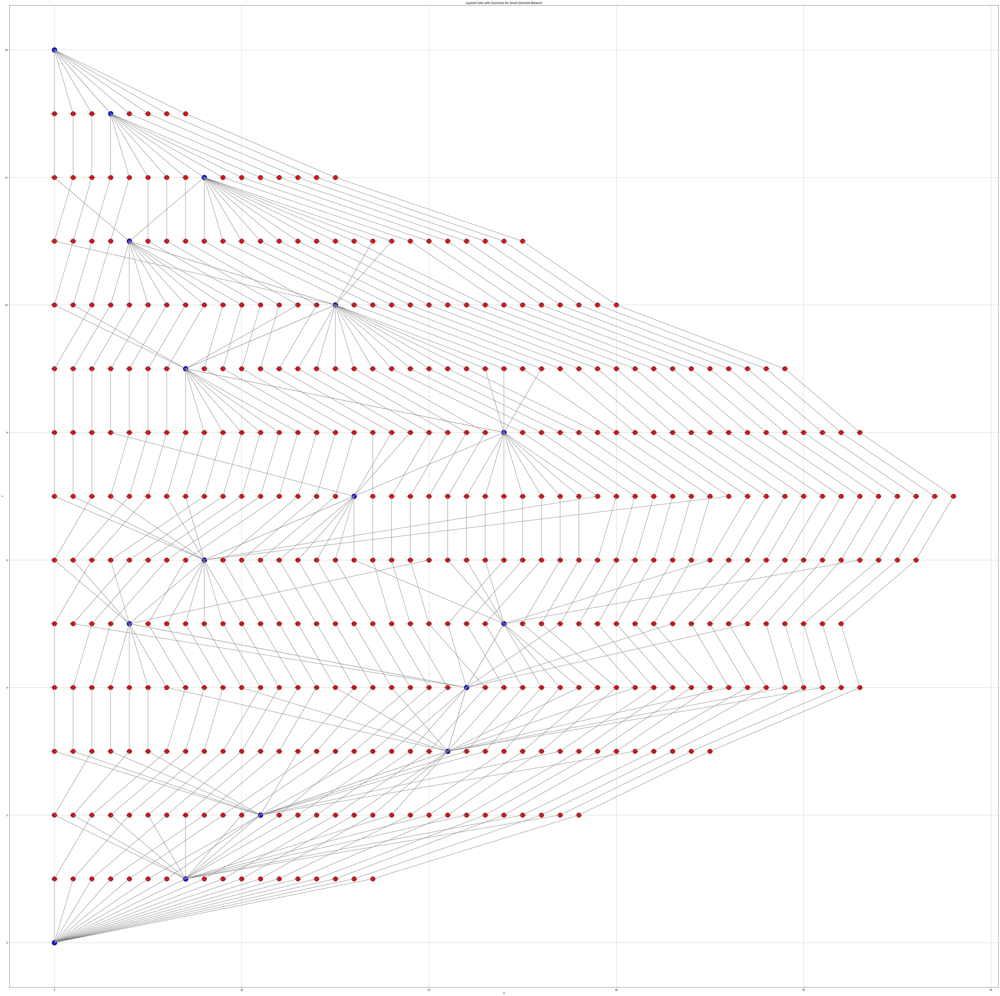

In [17]:
visualize_layerd_with_crossing(layers, layered_dummies_graph, fig_size, radius)


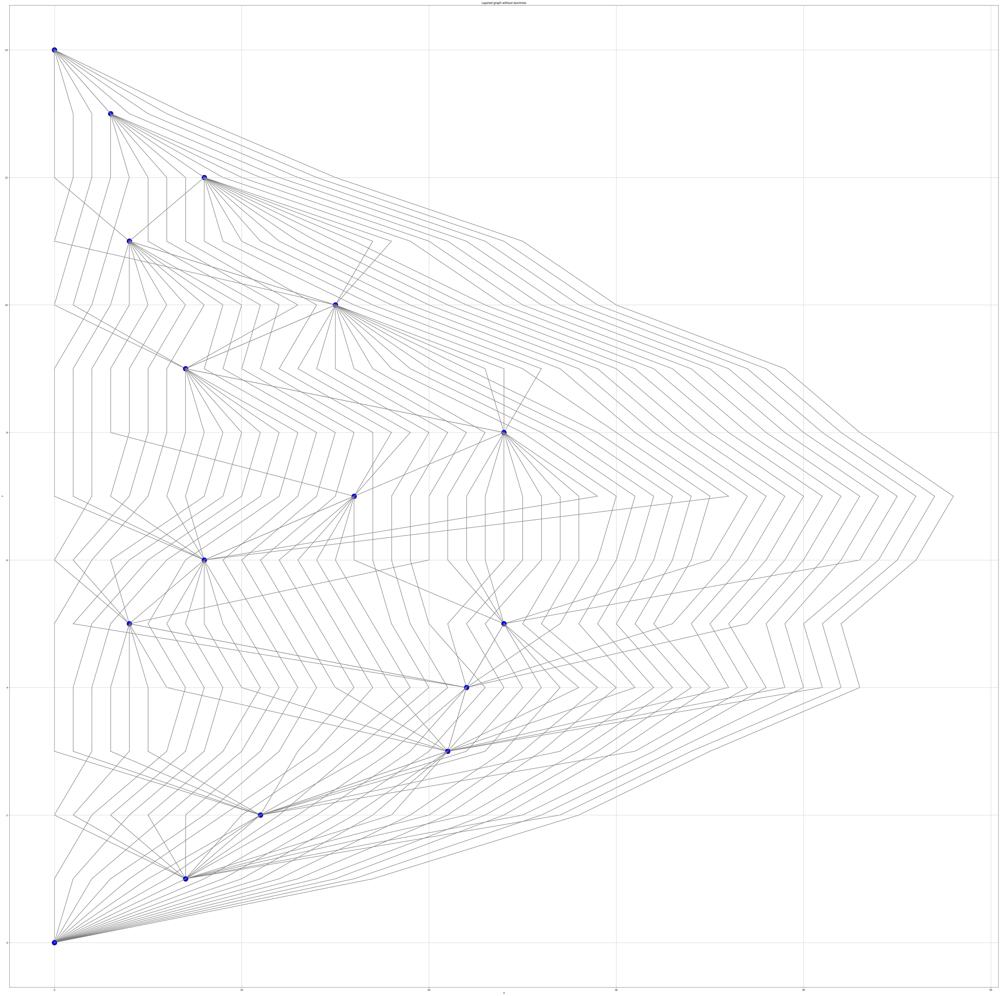

In [18]:
def visualize_layerd_with_crossing_without_dummies(layers, G, fig_size, radius):#(V^2+E)

  fig, ax = plt.subplots(figsize=(fig_size, fig_size))  # Adjust width and height as needed
  # Plot Vertices
  scaling_factor = 1 / len(G.vertices)
  for idx,layer in enumerate(layers):
      for idx1,vertex in enumerate(layer):
            #update_x_y
            G.update_x_y(vertex.id, idx1, idx)
            #if its dummy do not show it
            if vertex.id.startswith("D"):
              continue
            else:
              ax.scatter(idx1, idx, color='blue', zorder=2, s=scaling_factor * 40000 * (fig_size / 15),
                      edgecolors='black')
              ax.text(idx1, idx, str(vertex.id), fontsize=(scaling_factor * 40000 * (fig_size / 15)) / 50,
                    ha='center', va='center', zorder=len(G.vertices) * scaling_factor * 2, color='white')


  for edge in G.edges:
      start = edge.start
      end = edge.end
      dx = end.x - start.x
      dy = end.y - start.y
      if end.id.startswith("D"):
        ax.plot([start.x, end.x], [start.y, end.y],color='gray', zorder=1, linewidth=2)
      else:
        ax.annotate("", xy=(end.x, end.y), xytext=(start.x, start.y),
                    arrowprops=dict(arrowstyle="->", linewidth=2, color='gray'))


  ax.set_xlabel('X')
  ax.set_ylabel('Y')
  ax.set_title('Layered graph without dummies')
  ax.grid(True)
  plt.show()



fig_size=5+len(layered_dummies_graph.vertices)/6 # new line
radius=5+len(layered_dummies_graph.vertices)/4 # new line
visualize_layerd_with_crossing_without_dummies(layers, layered_dummies_graph, fig_size, radius)

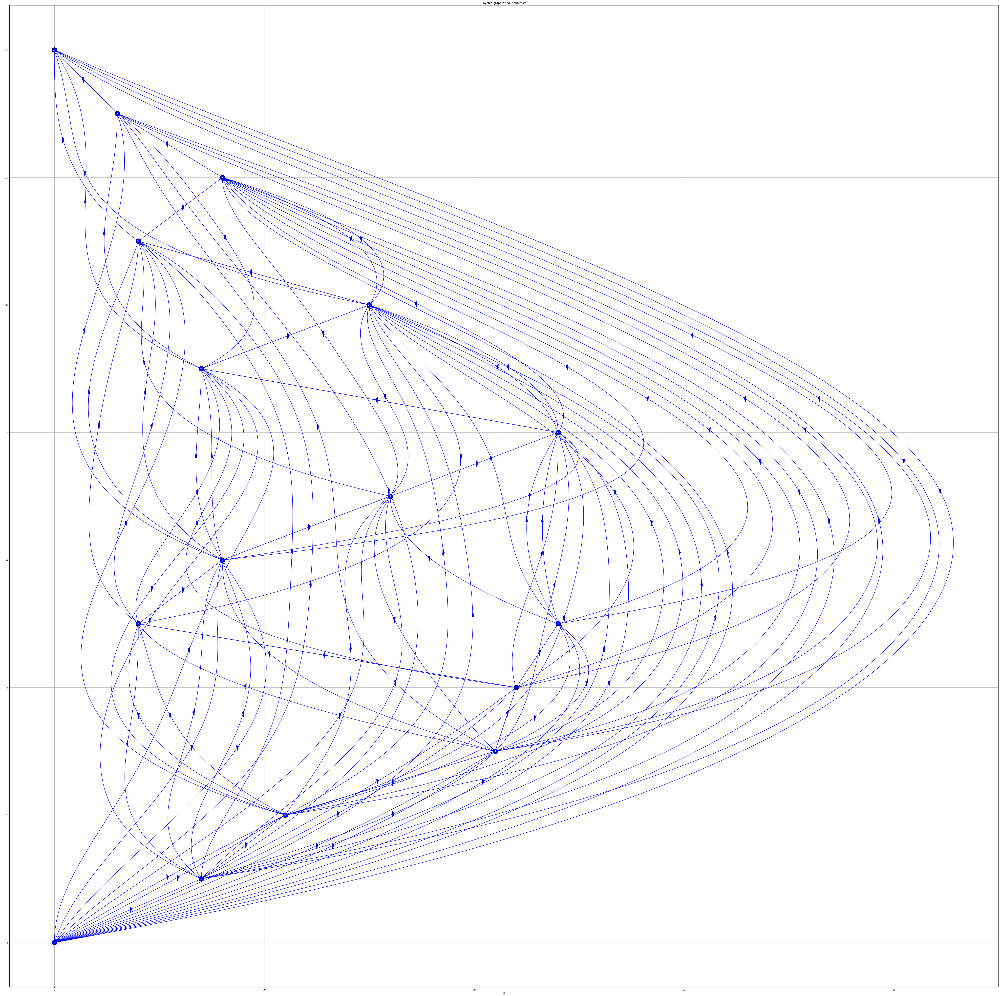

In [19]:
def bezier_curve(points, t):
    return sum([comb(len(points)-1,i) * ((1-t)**(len(points)-1-i)) * (t**i) * points[i] for i in range(len(points))])

def combine_edges(edges):
    combined_edges = []
    current_edge = []

    for edge in edges:
        if not edge.start.id.startswith("D"):
            if current_edge:
                combined_edges.append(np.array(current_edge))
                current_edge = []

            current_edge.append(np.array([edge.start.x, edge.start.y]))

        current_edge.append(np.array([edge.end.x, edge.end.y]))

    if current_edge:
        combined_edges.append(np.array(current_edge))

    return combined_edges


def visualize_layerd_with_crossing_without_dummies(layers, G, fig_size, radius):
    fig, ax = plt.subplots(figsize=(fig_size, fig_size))
    scaling_factor = 1 / len(G.vertices)
    
    edge_paths = combine_edges(G.edges)
    for p in edge_paths:
        curve_points = np.array([bezier_curve(p, t) for t in np.linspace(0, 1, 1000)])
        midpoint_index = len(curve_points) // 2
        midpoint = curve_points[midpoint_index]
        tangent_vector = curve_points[midpoint_index + 1] - curve_points[midpoint_index - 1]
        tangent_vector_normalized = tangent_vector / np.linalg.norm(tangent_vector)
        start_coord = midpoint - 0.1 * tangent_vector_normalized
        end_coord = midpoint + 0.1 * tangent_vector_normalized 
        plt.arrow(*start_coord, *(end_coord - start_coord), head_width=0.1, head_length=0.1, fc='blue', ec='blue', zorder=1)
        plt.plot(curve_points[:, 0], curve_points[:, 1], color='blue')  # Plot the curve
    
    for idx, layer in enumerate(layers):
        for idx1, vertex in enumerate(layer):
            G.update_x_y(vertex.id, idx1, idx)
            if not vertex.id.startswith("D"):
                ax.scatter(idx1, idx, color='blue', zorder=2, s=scaling_factor * 40000 * (fig_size / 15),
                edgecolors='black')
                ax.text(idx1, idx, str(vertex.id), fontsize=(scaling_factor * 40000 * (fig_size / 15)) / 50,
                ha='center', va='center', zorder=len(G.vertices) * scaling_factor * 2, color='white')

    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_title('Layered graph without dummies')
    ax.grid(True)
    plt.show()

fig_size=5+len(layered_dummies_graph.vertices)/6 # new line
radius=5+len(layered_dummies_graph.vertices)/4 # new line
visualize_layerd_with_crossing_without_dummies(layers, layered_dummies_graph, fig_size, radius)
